In [15]:
import wave
import numpy as np
import pandas as pd
import scipy.signal as sg
from pathlib import Path
import matplotlib.pyplot as plt

def calc_array_manifold_vector(theta, n_mic, n_bin, fs, N, c):
    # ysinΘ + xcosΘ
    """
    a: i x n_mic x 1 x n_bin
       方向数 x マイク数 x 1 x 周波数ビン数
    """
    rc = 0.0365
    mic_angle = np.array(
        [
            0,
            -np.pi / 4,
            -np.pi / 2,
            -np.pi * 3 / 4,
            np.pi,
            np.pi * 3 / 4,
            np.pi * 1 / 2,
            np.pi * 1 / 4,
        ]
    )
    a = np.zeros((theta.shape[0], n_mic, 1, n_bin), dtype=np.complex64)
    for i, th in enumerate(theta):
        th = np.radians(th)
        for k in range(n_bin):
            fk = fs * k / N
            for m in range(n_mic):
                delay = -rc * np.cos(th - mic_angle[m]) / c
                a[i, m, 0, k] = np.exp(-1j * 2 * np.pi * fk * delay)
    return a

def load_onefile(file_name):
    """
    return M x frames ndarray
    """
    wav = wave.open(file_name)
    # print("sample width:", wav.getsampwidth())
    # print("channel num:", wav.getnchannels())
    # print("frames:", wav.getnframes())

    M = wav.getnchannels()

    data = wav.readframes(wav.getnframes())
    data = np.frombuffer(data, dtype=np.int16)
    data = data / np.iinfo(np.int16).max

    multi_data = data.reshape(-1, M)
    multi_data = np.transpose(multi_data)
    # print("multi_data.shape:", multi_data.shape)

    wav.close()

    return multi_data

def MUSIC_indexbase(file_name, t_left_sec, t_right_sec, interval,  start_angle, end_angle, N, noverlap=None, weighting=True):
  """
  N: nperseg，窓関数の適用間隔
      noverlapは指定されなかった場合，デフォルトでnpersegの1/2になる
  """
  
  
  n_mic = 8
  n_src = 3
  window = "hann"
  c = 340
  freq_l = 100
  freq_h = 4000

  fs = 16000
  k_l = int(freq_l / (fs / N))
  k_h = int(freq_h / (fs / N))

  audio = load_onefile(file_name)

  # print(audio.shape)」
  if noverlap == None:
    noverlap = N / 2 
  
  # X: マイク数 x 周波数インデックス x 時間インデックス
  f, t, X = sg.stft(audio, fs, window=window, nperseg=N, noverlap=noverlap)
  n_bin = X.shape[1]
  
  t_left_index = (int)(t_left_sec // ((N - noverlap)/fs))
  t_right_index = (int)((t_right_sec + ((N - noverlap) / fs)) // ((N - noverlap) / fs))
  print(f"t_left_index: {t_left_index}")
  print(f"t_right_index: {t_right_index}")
  
  theta = np.linspace(
      start_angle, end_angle, num=((end_angle - start_angle) // 5) + 1
  )
  P_MU_LIST = None
  TIME_RANGE_LIST = None
  
  a = calc_array_manifold_vector(theta, n_mic, n_bin, fs, N, c)
  
  # t_left_index から interval　分だけインデックスをずらす t_right_index に到達するまで
  # ループ
  # やること：とりあえずtrim処理以下をまんまループに入れて実行
  # 書きかけて気づいたけど，特定範囲でのMUSICスペクトルを適宜出してほしい
  # ↑いやそんなことはない
  # 　まとめて処理して時間インデックスを持ってればいい
  #対応する時間範囲もreturnすればいいかも
  while t_left_index+interval < t_right_index:
    P_MU = np.zeros((theta.shape[0], f.shape[0]))
    # print(X.shape)
    X_trimed = X[:, :, t_left_index:(t_left_index+interval)]
    time_range = np.array([[t[t_left_index], t[t_left_index+interval]]])
    XH = np.conjugate(X_trimed)
    XXH = np.einsum("mki,nki->mnki", X_trimed, XH)
    R = np.mean(XXH, axis=3) # ここで時間平均を取っている(時間範囲での期待値に相当)

    eig_val = np.zeros((n_mic, n_bin), dtype=np.complex64)
    eig_vec = np.zeros((n_mic, n_mic, n_bin), dtype=np.complex64)
    beta = np.zeros(n_bin)
    for k in range(n_bin):
        eig_val_k, eig_vec_k = np.linalg.eig(
            R[:, :, k]
        )  # 周波数ごとに固有値、固有ベクトルを算出
        sort = np.argsort(-1.0 * np.abs(eig_val_k))
        eig_val[:, k] = eig_val_k[sort]
        eig_vec[:, :, k] = eig_vec_k[:, sort]

    W = eig_vec[:, n_src:, :]
    beta = np.sum(np.abs(eig_val[:n_src, :]), axis=0) # 固有値は各周波数のパワーなので，それを用いた重み付けのための項 参考：https://nettyukobo.com/music/

    for i, th in enumerate(theta):
        aH = np.conjugate(a[i])
        aHa = np.einsum("mik,mjk->ijk", aH, a[i])
        P_MU_th = np.einsum("mik,mek->iek", aH, W)
        P_MU_th = np.einsum("iek,jek->ijk", P_MU_th, np.conjugate(P_MU_th))
        P_MU_th = np.abs(aHa) / np.abs(P_MU_th)# ?
        if weighting is True:
          P_MU[i] = np.mean(beta[k_l : k_h + 1] * P_MU_th[0, 0, k_l : k_h + 1]) # 重み付けの計算，要素ごとの積をした後meanで1つの値に
        elif weighting is False:
          P_MU[i] = np.mean(P_MU_th[0, 0, :])
    
    if P_MU_LIST is None:
      P_MU_LIST = P_MU[np.newaxis, :, :]
    else:
      P_MU_LIST = np.concatenate((P_MU_LIST, [P_MU]), axis=0)
    
    if TIME_RANGE_LIST is None:
      TIME_RANGE_LIST = time_range
    else:
      TIME_RANGE_LIST = np.concatenate((TIME_RANGE_LIST, time_range), axis=0)
    
    t_left_index += interval

  # P_MU = 10 * np.log10(P_MU)

  return P_MU_LIST, TIME_RANGE_LIST

def calculate_interval_sec(interval, fs, N, noverlap=None):
  if noverlap == None:
    noverlap = N / 2
  print(f"interval is {((N - noverlap) / fs) * interval} sec.")
  
def display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, DISTANCE_LIST=None):
  start_angle = -180
  end_angle = 180
  theta = np.linspace(start_angle, end_angle, num=((end_angle-start_angle) // 5) + 1)
  theta = np.deg2rad(theta)
  
  P_MU_LIST_log = 10 * np.log10(P_MU_LIST)
  
  col_num = 5
  row_num = P_MU_LIST.shape[0] // 5 + 1
  
  plt.figure(figsize=(24, row_num * 5))

  for i in range(P_MU_LIST.shape[0]):

    ax = plt.subplot(
      row_num, col_num, i+1, projection="polar"
    )
    ax.plot(theta, P_MU_LIST[i])
    if DISTANCE_LIST is not None:
      ax.set_title(f"dist: {DISTANCE_LIST[i]}")
    ax.set_theta_zero_location("N")
    ax.set_theta_direction(-1)
    
def binary_search(arr, num):
  left = 0
  right = len(arr) - 1
  while left <= right:
    mid = (left + right) // 2
    if arr[mid] <= num:
      left = mid + 1
    if arr[mid] > num:
      right = mid - 1
  return right

def binary_search_upper_bound(arr, num):
  left = 0
  right = len(arr) - 1
  while left < right:
    mid = (left + right) // 2
    if arr[mid] <= num:
      left = mid + 1
    if arr[mid] > num:
      right = mid
  return left


def calc_mean_point(zero_csv_file_name):

  zero_field_df = pd.read_csv(zero_csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
    "field.ranges0": "float64", 
    "field.ranges1": "float64",
    "field.ranges2": "float64", 
    "field.ranges3": "float64",
    "field.ranges4": "float64"
  })
  zero_field_ndarray = zero_field_df.values
  zero_thre = np.mean(zero_field_ndarray[2])
  return zero_thre

interval is 0.192 sec.
t_left_index: 874
t_right_index: 1250
P_MU_LIST.shape: (32, 73, 257)
TIME_RANGE_LIST.shape: (32, 2)


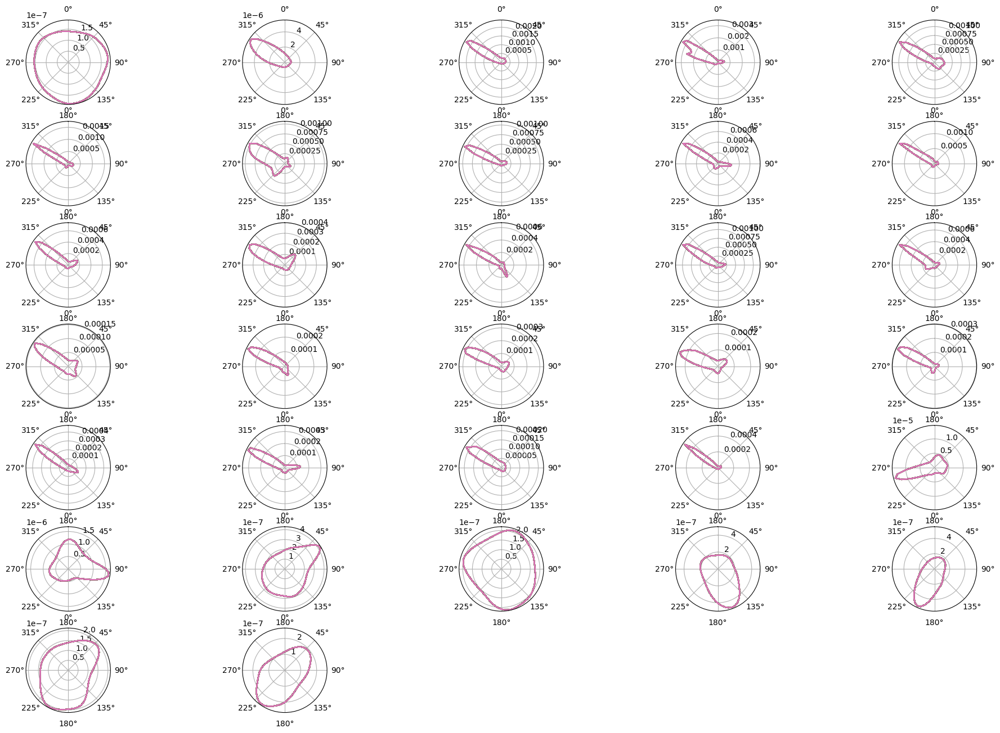

In [34]:
file_name = "/home/nishimura-k/audioprocessing/datas/audio_datas/30_-60_0.wav"

N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)
P_MU_LIST, TIME_RANGE_LIST = MUSIC_indexbase(file_name, t_left_sec=14, t_right_sec=20, interval=interval, start_angle=-180, end_angle=180, N=N)

print(f"P_MU_LIST.shape: {P_MU_LIST.shape}")
print(f"TIME_RANGE_LIST.shape: {TIME_RANGE_LIST.shape}")

P_MU_LIST_log = 10 * np.log10(P_MU_LIST)

display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST)

In [57]:
csv_file_name = "/home/nishimura-k/audioprocessing/datas/rosbag/to_csv_test_SB_harkwave.csv"
time_df = pd.read_csv(csv_file_name, usecols=["%time"], dtype={
  "%time":"int64"
})

field_df = pd.read_csv(csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
  "field.ranges0": "float64", 
  "field.ranges1": "float64",
  "field.ranges2": "float64", 
  "field.ranges3": "float64",
  "field.ranges4": "float64"
})

# numpyで指定されたprecisionの分しか小数点以下は表示されないらしい
# print(np.get_printoptions())


time_ndarray = time_df.values
field_ndarray = field_df.values
#print(field_ndarray[0, 0] - 7.75)
print(time_ndarray)
print(field_ndarray)

[[1724739071754805299]
 [1724739071780128034]
 [1724739071805105297]
 ...
 [1724739106324059998]
 [1724739106349088316]
 [1724739106374068455]]
[[7.75699997 7.76399994 7.76399994 7.7579999  7.75400019]
 [7.75699997 7.74499989 7.7420001  7.7420001  7.75400019]
 [7.76000023 7.75600004 7.75600004 7.76100016 7.76100016]
 ...
 [7.76599979 7.76399994 7.75600004 7.75400019 7.74599981]
 [7.76900005 7.76499987 7.75299978 7.74100018 7.74100018]
 [7.7579999  7.75899982 7.75899982 7.74800014 7.7420001 ]]


In [61]:
fixed_time_col = time_ndarray - time_ndarray[0]
fixed_time_col = fixed_time_col / (10 ** 9)
# print(fixed_time_col)
time_and_field = np.concatenate([fixed_time_col, field_ndarray], axis=1)


# 列は 0基準の時間, フィールド0, フィールド1, ... , フィールド4
# print(time_and_field)
# print(time_and_field[:, 0])

DISTANCE_LIST = np.zeros(TIME_RANGE_LIST.shape[0])

for i in range(TIME_RANGE_LIST.shape[0]):
  left_lidar_time_index = binary_search(time_and_field[:, 0], TIME_RANGE_LIST[i, 0])
  right_lidar_time_index = binary_search_upper_bound(time_and_field[:, 0], TIME_RANGE_LIST[i, 1])
  distance = np.mean(time_and_field[:, 3][left_lidar_time_index:right_lidar_time_index])
  DISTANCE_LIST[i] = distance

print(DISTANCE_LIST)
  
  


[0.72524999 0.72488889 0.72544444 0.725      0.71911111 0.69711112
 0.674      0.67222223 0.67644444 0.673125   0.678      0.67966666
 0.683      0.68344444 0.67988889 0.67962501 0.67522222 0.67377778
 0.67425    0.6731111  0.67077778 0.67537501 0.67355555 0.6708889
 0.66999999 0.67244444 0.67177778 0.676      0.70466667 0.75688889
 0.7745     0.76833333]


(8, 552992)


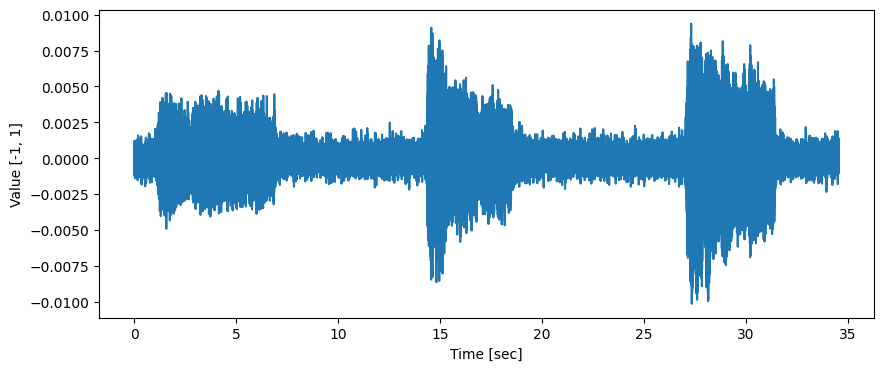

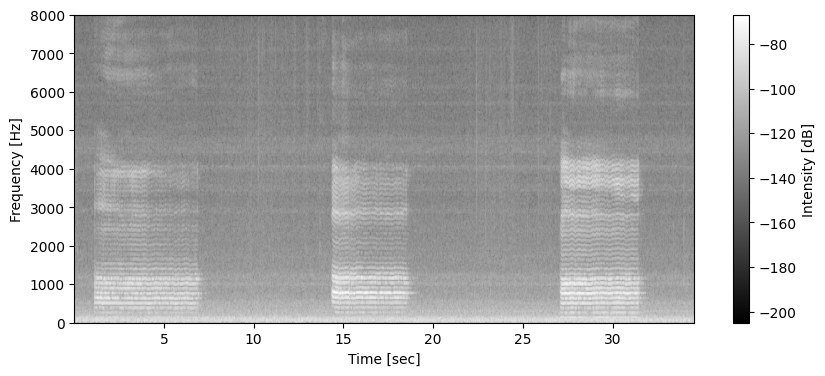

In [87]:
file_name = "/home/nishimura-k/audioprocessing/datas/audio_datas/30_-60_0.wav"
sample_rate = 16000
audio = load_onefile(file_name)

print(audio.shape)
x = np.array(range(audio.shape[1])) / sample_rate

plt.figure(figsize=(10, 4))
plt.xlabel("Time [sec]")
plt.ylabel("Value [-1, 1]")
plt.plot(x, audio[0])

fig=plt.figure(figsize=(10, 4))
spectrum, f, t, im=plt.specgram(audio[0], NFFT=512, noverlap=256, Fs=16000, cmap="gray")
fig.colorbar(im).set_label("Intensity [dB]")
plt.xlabel("Time [sec]")
plt.ylabel("Frequency [Hz]")
plt.show()

interval is 0.192 sec.
t_left_index: 62
t_right_index: 2063


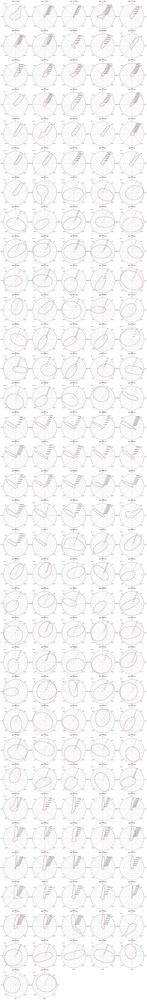

In [92]:
# 今回は，MUSICに対応する時間範囲における距離（または角度のラベル）だけを表示(csvに出力)できたらok
# SB棟で記録したテスト用音声
file_name = "/home/nishimura-k/audioprocessing/datas/audio_datas/30_-60_0.wav"

# MUSICスペクトルを計算
N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)
P_MU_LIST, TIME_RANGE_LIST = MUSIC_indexbase(file_name, t_left_sec=1, t_right_sec=33, interval=interval, start_angle=-180, end_angle=180, N=N, weighting=True)

# DISTANCEを読み出し
csv_file_name = "/home/nishimura-k/audioprocessing/datas/rosbag/to_csv_test_SB_harkwave.csv"
time_df = pd.read_csv(csv_file_name, usecols=["%time"], dtype={
  "%time":"int64"
})

field_df = pd.read_csv(csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
  "field.ranges0": "float64", 
  "field.ranges1": "float64",
  "field.ranges2": "float64", 
  "field.ranges3": "float64",
  "field.ranges4": "float64"
})

time_ndarray = time_df.values
field_ndarray = field_df.values

fixed_time_col = time_ndarray - time_ndarray[0]
fixed_time_col = fixed_time_col / (10 ** 9)
# print(fixed_time_col)
time_and_field = np.concatenate([fixed_time_col, field_ndarray], axis=1)
# print(time_and_field)

DISTANCE_LIST = np.zeros(TIME_RANGE_LIST.shape[0])

# print(f"TIME_RANGE_LIST: {TIME_RANGE_LIST}")



for i in range(TIME_RANGE_LIST.shape[0]):
  left_lidar_time_index = binary_search(time_and_field[:, 0], TIME_RANGE_LIST[i, 0])
  right_lidar_time_index = binary_search_upper_bound(time_and_field[:, 0], TIME_RANGE_LIST[i, 1])
  distance = np.mean(time_and_field[:, 3][left_lidar_time_index:right_lidar_time_index])
  DISTANCE_LIST[i] = distance
  
DISTANCE_LIST = np.floor(DISTANCE_LIST * 10000) / 10000

# print(f"DISTANCE_LIST: {DISTANCE_LIST}")

# MUSICスペクトルを可視化
# P_MU_LIST = 10 * np.log10(P_MU_LIST)

display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, DISTANCE_LIST=DISTANCE_LIST)

(8, 264512)


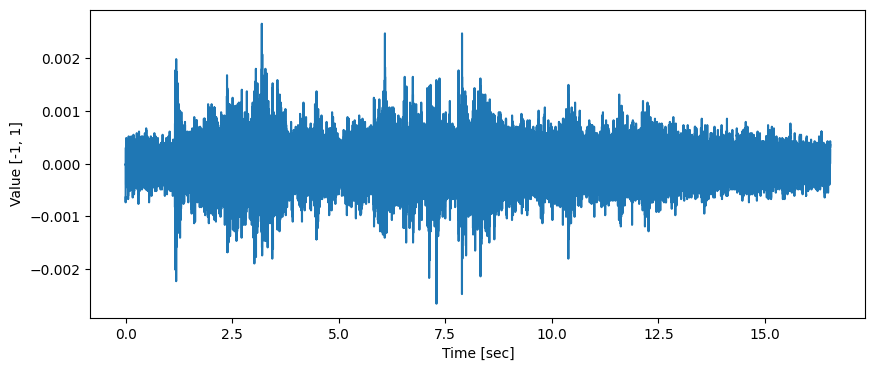

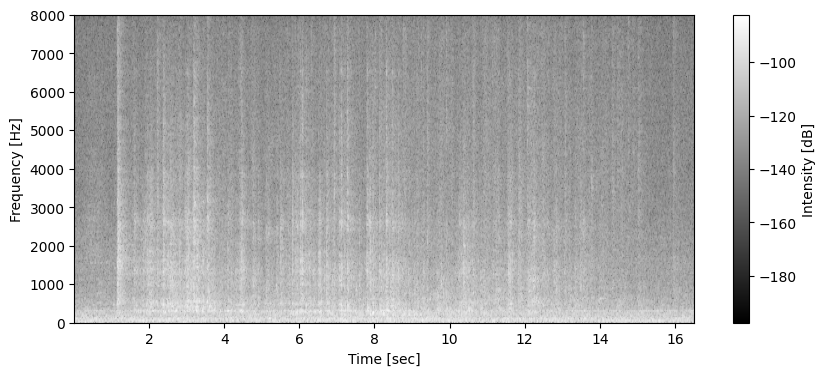

In [13]:
file_name = "/home/nishimura-k/audioprocessing/datas/audio_datas/ltor_150_wireless_test1_0.wav"
sample_rate = 16000
audio = load_onefile(file_name)

print(audio.shape)
x = np.array(range(audio.shape[1])) / sample_rate

plt.figure(figsize=(10, 4))
plt.xlabel("Time [sec]")
plt.ylabel("Value [-1, 1]")
plt.plot(x, audio[0])

fig=plt.figure(figsize=(10, 4))
spectrum, f, t, im=plt.specgram(audio[0], NFFT=512, noverlap=256, Fs=16000, cmap="gray")
fig.colorbar(im).set_label("Intensity [dB]")
plt.xlabel("Time [sec]")
plt.ylabel("Frequency [Hz]")
plt.show()

interval is 0.192 sec.
t_left_index: 0
t_right_index: 1034
[[ 0.        ]
 [ 0.02463531]
 [ 0.04980594]
 [ 0.07441598]
 [ 0.09930199]
 [ 0.12422008]
 [ 0.14915317]
 [ 0.17413906]
 [ 0.19911651]
 [ 0.22399343]
 [ 0.2488302 ]
 [ 0.27384027]
 [ 0.29842994]
 [ 0.32331064]
 [ 0.34839275]
 [ 0.37354073]
 [ 0.39851611]
 [ 0.42327446]
 [ 0.44846931]
 [ 0.47338682]
 [ 0.49824251]
 [ 0.5234445 ]
 [ 0.54795125]
 [ 0.57321494]
 [ 0.59788986]
 [ 0.62267652]
 [ 0.64750026]
 [ 0.67281433]
 [ 0.69766534]
 [ 0.72271719]
 [ 0.7475503 ]
 [ 0.77238642]
 [ 0.79781046]
 [ 0.82182226]
 [ 0.84662815]
 [ 0.87177509]
 [ 0.89673651]
 [ 0.92162178]
 [ 0.9465439 ]
 [ 0.97169953]
 [ 0.9965489 ]
 [ 1.02148162]
 [ 1.04633805]
 [ 1.07155136]
 [ 1.09613152]
 [ 1.12175308]
 [ 1.14590889]
 [ 1.17099644]
 [ 1.19566135]
 [ 1.22151502]
 [ 1.24577773]
 [ 1.27076268]
 [ 1.29539887]
 [ 1.32089237]
 [ 1.34510423]
 [ 1.37035178]
 [ 1.39522985]
 [ 1.42089347]
 [ 1.44494547]
 [ 1.47001184]
 [ 1.49465214]
 [ 1.51979693]
 [ 1.544665

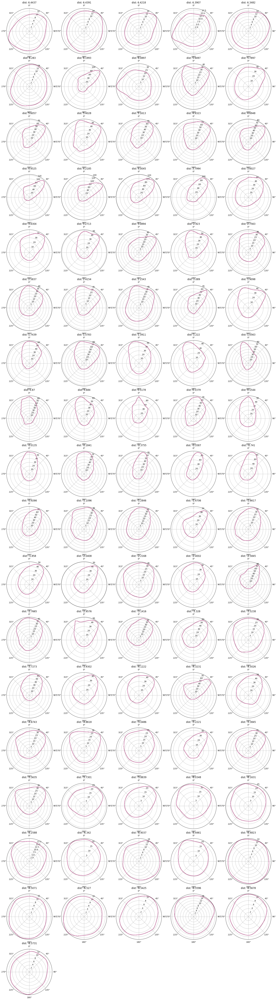

In [12]:
# 今回は，MUSICに対応する時間範囲における距離（または角度のラベル）だけを表示(csvに出力)できたらok
# 距離を計算するバージョン
file_name = "/home/nishimura-k/audioprocessing/datas/audio_datas/ltor_150_wireless_test1_0.wav"

# MUSICスペクトルを計算
N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)


audio = load_onefile(file_name)
t_left_sec = 0
t_right_sec = audio.shape[1] / fs

P_MU_LIST, TIME_RANGE_LIST = MUSIC_indexbase(file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=180, N=N, weighting=False)

# DISTANCEを読み出し
csv_file_name = "/home/nishimura-k/audioprocessing/datas/csv/ltor_150_wireless_test1.csv"
distance_0_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_center_test.csv"

time_df = pd.read_csv(csv_file_name, usecols=["%time"], dtype={
  "%time":"int64"
})

field_df = pd.read_csv(csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
  "field.ranges0": "float64", 
  "field.ranges1": "float64",
  "field.ranges2": "float64", 
  "field.ranges3": "float64",
  "field.ranges4": "float64"
})

time_ndarray = time_df.values
field_ndarray = field_df.values

fixed_time_col = time_ndarray - time_ndarray[0]
fixed_time_col = fixed_time_col / (10 ** 9)
# print(fixed_time_col)
zero_point = calc_mean_point(distance_0_csv)
field_ndarray = field_ndarray - zero_point

time_and_field = np.concatenate([fixed_time_col, field_ndarray], axis=1)
# print(time_and_field)

DISTANCE_LIST = np.zeros(TIME_RANGE_LIST.shape[0])

# print(f"TIME_RANGE_LIST: {TIME_RANGE_LIST}")


# MUSIC適用範囲のLiDARのデータを探し，その区間での距離の平均を取っている
for i in range(TIME_RANGE_LIST.shape[0]):
  left_lidar_time_index = binary_search(time_and_field[:, 0], TIME_RANGE_LIST[i, 0])
  right_lidar_time_index = binary_search_upper_bound(time_and_field[:, 0], TIME_RANGE_LIST[i, 1])
  distance = np.mean(time_and_field[:, 3][left_lidar_time_index:right_lidar_time_index])
  DISTANCE_LIST[i] = distance
  
DISTANCE_LIST = np.floor(DISTANCE_LIST * 10000) / 10000

# print(f"DISTANCE_LIST: {DISTANCE_LIST}")

# MUSICスペクトルを可視化
# # P_MU_LIST = 10 * np.log10(P_MU_LIST)

# display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, DISTANCE_LIST=DISTANCE_LIST)

interval is 0.192 sec.
t_left_index: 0
t_right_index: 881


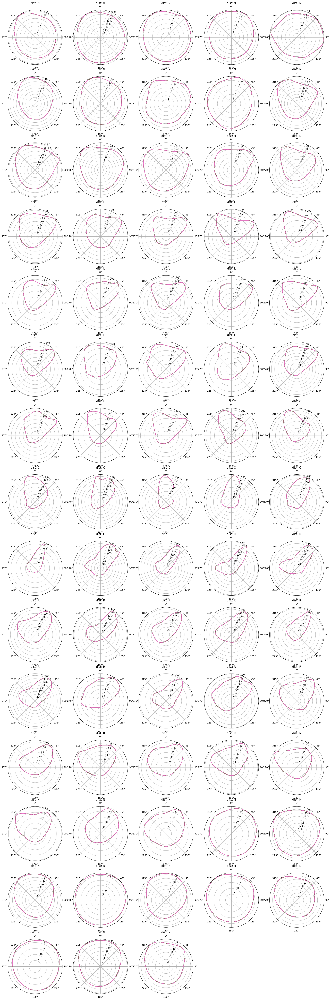

In [21]:
# 今回は，MUSICに対応する時間範囲における距離（または角度のラベル）だけを表示(csvに出力)できたらok
# 距離を計算するバージョン
file_name = "/home/nishimura-k/audioprocessing/datas/audio_datas/ltor_100_wireless_test1_0.wav"

# MUSICスペクトルを計算
N = 512
interval = 12
fs = 16000
calculate_interval_sec(interval, fs, N)


audio = load_onefile(file_name)
t_left_sec = 0
t_right_sec = audio.shape[1] / fs

P_MU_LIST, TIME_RANGE_LIST = MUSIC_indexbase(file_name, t_left_sec=t_left_sec, t_right_sec=t_right_sec, interval=interval, start_angle=-180, end_angle=180, N=N, weighting=False)

# DISTANCEを読み出し
csv_file_name = "/home/nishimura-k/audioprocessing/datas/csv/ltor_100_wireless_test1.csv"
distance_0_csv = "/home/nishimura-k/audioprocessing/datas/csv/ltor_center_test.csv"
distance_left_thre_csv = "/home/nishimura-k/audioprocessing/datas/rosbag/ltor_left_thre_test.csv"
distance_right_thre_csv = "/home/nishimura-k/audioprocessing/datas/rosbag/ltor_right_thre_test.csv"

time_df = pd.read_csv(csv_file_name, usecols=["%time"], dtype={
  "%time":"int64"
})

field_df = pd.read_csv(csv_file_name, usecols=["field.ranges0", "field.ranges1", "field.ranges2", "field.ranges3", "field.ranges4"], dtype={
  "field.ranges0": "float64", 
  "field.ranges1": "float64",
  "field.ranges2": "float64", 
  "field.ranges3": "float64",
  "field.ranges4": "float64"
})

time_ndarray = time_df.values
field_ndarray = field_df.values

fixed_time_col = time_ndarray - time_ndarray[0]
fixed_time_col = fixed_time_col / (10 ** 9)
# print(fixed_time_col)
zero_point = calc_mean_point(distance_0_csv)
field_ndarray = field_ndarray - zero_point

time_and_field = np.concatenate([fixed_time_col, field_ndarray], axis=1)
# print(time_and_field)

DISTANCE_LIST = np.zeros(TIME_RANGE_LIST.shape[0])

# print(f"TIME_RANGE_LIST: {TIME_RANGE_LIST}")


# MUSIC適用範囲のLiDARのデータを探し，その区間での距離の平均を取っている
for i in range(TIME_RANGE_LIST.shape[0]):
  left_lidar_time_index = binary_search(time_and_field[:, 0], TIME_RANGE_LIST[i, 0])
  right_lidar_time_index = binary_search_upper_bound(time_and_field[:, 0], TIME_RANGE_LIST[i, 1])
  distance = np.mean(time_and_field[:, 3][left_lidar_time_index:right_lidar_time_index])
  DISTANCE_LIST[i] = distance
  
DISTANCE_LIST = np.floor(DISTANCE_LIST * 10000) / 10000

left_thre = calc_mean_point(distance_left_thre_csv) - zero_point
right_thre = calc_mean_point(distance_right_thre_csv) - zero_point
LABEL_LIST = np.full(DISTANCE_LIST.shape[0], "", dtype=str)
cart_size = 0.78
# print(DISTANCE_LIST)
for i in range(LABEL_LIST.shape[0]):
  x = DISTANCE_LIST[i]
  if x > DISTANCE_LIST[0]-cart_size:
    LABEL_LIST[i] = "NONE"
  elif DISTANCE_LIST[0]-cart_size >= x and x > left_thre:
    LABEL_LIST[i] = "LEFT"
  elif left_thre >= x and x > right_thre:
    LABEL_LIST[i] = "CENTER"
  elif right_thre >= x and x > DISTANCE_LIST[-1] + cart_size:
    LABEL_LIST[i] = "RIGHT"
  elif DISTANCE_LIST[-1] + cart_size > x:
    LABEL_LIST[i] = "NONE"
  else:
    LABEL_LIST[i] = "UNDIFINED"
    

# print(f"DISTANCE_LIST: {DISTANCE_LIST}")

# MUSICスペクトルを可視化
# # P_MU_LIST = 10 * np.log10(P_MU_LIST)

display_one_file_indexbase(P_MU_LIST, TIME_RANGE_LIST, DISTANCE_LIST=LABEL_LIST)